# Frontal Detection Analysis (visualize all fronts on one map)

In [2]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt

In [3]:
file_path = "/glade/work/kdagon/FrontDetector/CESMOutputs/"

In [4]:
fronts_file = "cesm_fronts_2000-2005.nc"
onehot_file = "cesm_frontsOneHot_2000-2005.nc"
rates_file = "cesm_frontRates_2000-2005.nc"
rates_file_viaPoly = "cesm_fronts_2000-2005_frontRates_viaPolylines.nc"

## Read in predicted fronts file

In [4]:
pred_fronts = xr.open_dataset(file_path+fronts_file)
#pred_fronts

In [5]:
#pred_fronts.front_type

In [5]:
pfronts = pred_fronts.predicted_fronts
#pfronts

## Plot the predicted fronts over time 

In [21]:
import cartopy
import cartopy.crs as ccrs
from matplotlib import cm
import matplotlib.colors 
from cartopy.util import add_cyclic_point
import cartopy.feature as cfeature

In [ ]:
# for interactive visualization
import holoviews as hv
import geoviews as gv
import hvplot.xarray 
hv.extension('bokeh')

Set display preferences

In [ ]:
%output holomap='scrubber' fps=10

## Visualize all fronts on one map.
Use argmax to find the maximum probability of a type of front along the front axis.

For cartopy projections, see: https://scitools.org.uk/cartopy/docs/latest/crs/projections.html

In [7]:
# making a custom colorbar with blue for cold, red for warm, grey for stationary, 
# purple for occluded, and white for none fronts.

cmap = matplotlib.colors.ListedColormap(['blue', 'red', 'grey', 'purple', 'w'])

In [10]:
plot_all = pfronts.argmax(dim='front').hvplot(x='lon', y='lat', z='predicted_fronts', kind='contourf', groupby='time',
                          cmap=cmap, projection=ccrs.LambertCylindrical())

In [21]:
plot_all * gv.feature.grid * gv.feature.coastline

:DynamicMap   [time]
   :Overlay
      .Polygons.I  :Polygons   [lon,lat]   (predicted_fronts)
      .Grid.I      :Feature   [Longitude,Latitude]
      .Coastline.I :Feature   [Longitude,Latitude]

## Read in one-hot fronts file

In [5]:
onehot = xr.open_dataset(file_path+onehot_file)
onehot

<xarray.Dataset>
Dimensions:     (front: 5, lat: 68, lon: 141, time: 17520)
Coordinates:
  * time        (time) object 2000-01-01 03:00:00 ... 2006-01-01 00:00:00
  * lat         (lat) float64 10.0 11.0 12.0 13.0 14.0 ... 74.0 75.0 76.0 77.0
  * lon         (lon) float64 189.0 190.0 191.0 192.0 ... 327.0 328.0 329.0
    front_type  (front) object ...
Dimensions without coordinates: front
Data variables:
    fronts      (time, front, lat, lon) float32 ...
Attributes:
    source:       CAM
    Conventions:  CF-1.8
    title:        Frontal boundary location predictions from model inputs
    summary:      This file contains grids showing probabilities of frontal b...
    history:      2020-09-22T15:26:58.667360Z converted to one-hot.\n\n2020-0...

In [6]:
fronts = onehot.fronts
fronts

<xarray.DataArray 'fronts' (time: 17520, front: 5, lat: 68, lon: 141)>
[839908800 values with dtype=float32]
Coordinates:
  * time        (time) object 2000-01-01 03:00:00 ... 2006-01-01 00:00:00
  * lat         (lat) float64 10.0 11.0 12.0 13.0 14.0 ... 74.0 75.0 76.0 77.0
  * lon         (lon) float64 189.0 190.0 191.0 192.0 ... 327.0 328.0 329.0
    front_type  (front) object ...
Dimensions without coordinates: front
Attributes:
    long_name:     one-hot predicted fronts
    grid_mapping:  crs
    valid_min:     0
    valid_max:     1

In [22]:
onehot_all = fronts.argmax(dim='front').hvplot(x='lon', y='lat', z='fronts', kind='contourf', groupby='time',
                          cmap=cmap, projection=ccrs.LambertCylindrical())
onehot_all * gv.feature.grid * gv.feature.coastline

:DynamicMap   [time]
   :Overlay
      .Polygons.I  :Polygons   [lon,lat]   (fronts)
      .Grid.I      :Feature   [Longitude,Latitude]
      .Coastline.I :Feature   [Longitude,Latitude]

## Animation of all fronts

In [7]:
allfronts = fronts.argmax(dim='front')

In [23]:
# making a custom colorbar with blue for cold, red for warm, grey for stationary, 
# purple for occluded, and white for none fronts.

cmap_all = matplotlib.colors.ListedColormap(['blue', 'red', 'grey', 'purple', 'w'])
bounds = [0, 0.99, 1.99, 2.99, 3.99, 4.99]
norm = matplotlib.colors.BoundaryNorm(bounds, cmap_all.N)

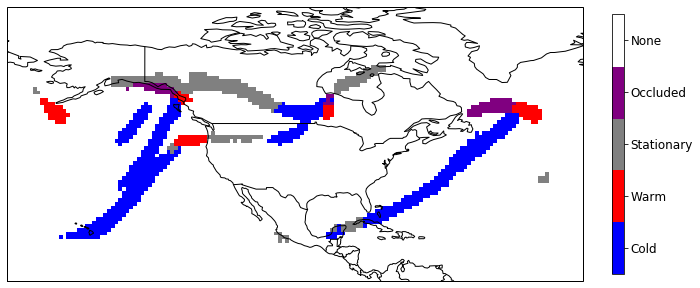

In [36]:
fig = plt.figure(figsize=(8,6))

ax = fig.add_axes([0.,0.,1.,1.], projection=ccrs.PlateCarree())

# start with the first time index
field, lon = add_cyclic_point(allfronts[0,:,:], coord=allfronts.lon)
lat = allfronts.lat
#cf = ax.contourf(lon, lat, field, cmap=cmap_all, vmin=0, vmax=4.99, levels=bounds, transform=ccrs.PlateCarree())
cf = ax.pcolormesh(lon, lat, field, cmap=cmap_all, vmin=0, vmax=4.99, norm=norm, transform=ccrs.PlateCarree()) # trying to get rid of contourf interpolation

ax.coastlines()
ax.add_feature(cfeature.BORDERS)

import matplotlib as mpl
cbar_ax = fig.add_axes([1.05, 0.2, 0.02, 0.6])
norm = mpl.colors.Normalize(vmin=0, vmax=4.99)
cb1 = mpl.colorbar.ColorbarBase(cbar_ax, 
                                cmap=cmap_all,
                                norm=norm,
                                orientation='vertical', 
                               ticks=bounds)
labels = np.array([0, 0.99, 1.99, 2.99, 3.99])
loc    = labels + .5
tick_1 = ['Cold','Warm','Stationary','Occluded','None']
cb1.set_ticks(loc)
cb1.ax.set_yticklabels(tick_1)
cb1.ax.tick_params(labelsize=12)

In [34]:
allfronts_2000_jan = allfronts.sel(time=slice("2000-01-01", "2000-01-31"))
len(allfronts_2000_jan)

247

## Validation data: Coded Surface Bulletin fronts

In [8]:
csb_file_path = "/glade/work/kdagon/ML-extremes/data/CODSUS/MERRA2/"
csb_fronts_file = "codsus_merra2-1deg_3wide_2003.nc"

In [9]:
csb_fronts = xr.open_dataset(csb_file_path+csb_fronts_file)
csb_fronts

<xarray.Dataset>
Dimensions:     (front: 5, lat: 68, lon: 141, time: 2866)
Coordinates:
  * lat         (lat) float64 10.0 11.0 12.0 13.0 14.0 ... 74.0 75.0 76.0 77.0
    front_type  (front) object ...
  * lon         (lon) float64 -171.0 -170.0 -169.0 -168.0 ... -33.0 -32.0 -31.0
  * time        (time) datetime64[ns] 2003-01-03T12:00:00 ... 2003-12-31T21:00:00
Dimensions without coordinates: front
Data variables:
    crs         float64 ...
    fronts      (time, front, lat, lon) float32 ...
Attributes:
    title:        Coded surface bulletins with masking on a merra2-1deg grid.
    history:      2019-03-13T19:11:11.427012: ./../Python/jsonPolysToMaskedNe...
    institution:  North Carolina Institute for Climate Studies (NCICS)
    Conventions:  CF-1.7

In [10]:
csb_fronts_da = csb_fronts.fronts
csb_fronts_da

<xarray.DataArray 'fronts' (time: 2866, front: 5, lat: 68, lon: 141)>
[137396040 values with dtype=float32]
Coordinates:
  * lat         (lat) float64 10.0 11.0 12.0 13.0 14.0 ... 74.0 75.0 76.0 77.0
    front_type  (front) object ...
  * lon         (lon) float64 -171.0 -170.0 -169.0 -168.0 ... -33.0 -32.0 -31.0
  * time        (time) datetime64[ns] 2003-01-03T12:00:00 ... 2003-12-31T21:00:00
Dimensions without coordinates: front
Attributes:
    long_name:     front line images
    valid_min:     0
    grid_mapping:  crs
    valid_max:     1

In [11]:
allfronts_csb = csb_fronts_da.argmax(dim='front')

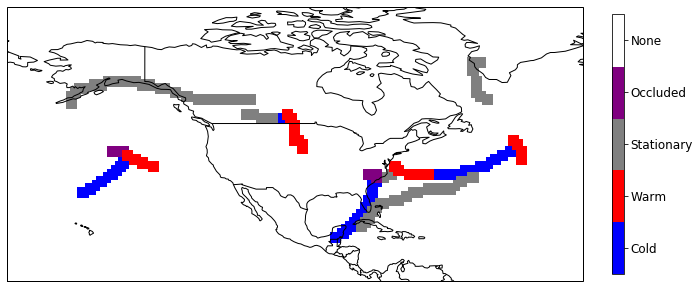

In [35]:
fig = plt.figure(figsize=(8,6))

ax = fig.add_axes([0.,0.,1.,1.], projection=ccrs.PlateCarree())

# start with the first time index
field, lon = add_cyclic_point(allfronts_csb[0,:,:], coord=allfronts_csb.lon)
lat = allfronts_csb.lat
cf = ax.pcolormesh(lon, lat, field, cmap=cmap_all, vmin=0, vmax=4.99, norm=norm, transform=ccrs.PlateCarree())

ax.coastlines()
ax.add_feature(cfeature.BORDERS)

import matplotlib as mpl
cbar_ax = fig.add_axes([1.05, 0.2, 0.02, 0.6])
norm = mpl.colors.Normalize(vmin=0, vmax=4.99)
cb1 = mpl.colorbar.ColorbarBase(cbar_ax, 
                                cmap=cmap_all,
                                norm=norm,
                                orientation='vertical', 
                               ticks=bounds)
labels = np.array([0, 0.99, 1.99, 2.99, 3.99])
loc    = labels + .5
tick_1 = ['Cold','Warm','Stationary','Occluded','None']
cb1.set_ticks(loc)
cb1.ax.set_yticklabels(tick_1)
cb1.ax.tick_params(labelsize=12)

Select time slice for animation

In [29]:
allfronts_csb_2003_jan = allfronts_csb.sel(time=slice("2003-01-01", "2003-01-31"))
len(allfronts_csb_2003_jan) # length is slightly shorter than CESM January 2000 because CSB starts Jan 3 2003 (?)

226

In [31]:
allfronts_csb_2003_jan.time

<xarray.DataArray 'time' (time: 226)>
array(['2003-01-03T12:00:00.000000000', '2003-01-03T15:00:00.000000000',
       '2003-01-03T18:00:00.000000000', ..., '2003-01-31T15:00:00.000000000',
       '2003-01-31T18:00:00.000000000', '2003-01-31T21:00:00.000000000'],
      dtype='datetime64[ns]')
Coordinates:
  * time     (time) datetime64[ns] 2003-01-03T12:00:00 ... 2003-01-31T21:00:00
Attributes:
    long_name:      time
    standard_name:  time
    axis:           T

## Generate the static files for the animation

In [37]:
# toggle CESM or CSB
for counter, ind in enumerate(np.arange(0,len(allfronts_2000_jan))):
#for counter, ind in enumerate(np.arange(0,len(allfronts_csb_2003_jan))):
    
    iterate = "{:03d}".format(counter) # modify significant digits depends on length of files

    fig = plt.figure(figsize=(8,6))
    ax = fig.add_axes([0.,0.,1.,1.], projection=ccrs.PlateCarree())
    
    
    field, lon = add_cyclic_point(allfronts_2000_jan[ind,:,:], coord=allfronts.lon)
    lat = allfronts.lat
    cf = ax.pcolormesh(lon, lat, field, cmap=cmap_all, vmin=0, vmax=4.99, norm=norm, transform=ccrs.PlateCarree())
    
    ax.coastlines()
    ax.add_feature(cfeature.BORDERS)
    
    import matplotlib as mpl
    cbar_ax = fig.add_axes([1.05, 0.2, 0.02, 0.6])
    norm = mpl.colors.Normalize(vmin=0, vmax=4.99)
    cb1 = mpl.colorbar.ColorbarBase(cbar_ax, 
                                cmap=cmap_all,
                                norm=norm,
                                orientation='vertical', 
                               ticks=bounds)
    labels = np.array([0, 0.99, 1.99, 2.99, 3.99])
    loc    = labels + .5
    tick_1 = ['Cold','Warm','Stationary','Occluded','None']
    cb1.set_ticks(loc)
    cb1.ax.set_yticklabels(tick_1)
    cb1.ax.tick_params(labelsize=12)
    
    #plt.savefig(f'../figures/fronts_animation/allfronts_2000_jan_{iterate}.png', bbox_inches='tight', dpi=200)
    plt.savefig(f'../figures/fronts_animation/cesm_allfronts_2000_jan_{iterate}.png', bbox_inches='tight', dpi=200)
    #plt.savefig(f'../figures/fronts_animation/csb_allfronts_2003_jan_{iterate}.png', bbox_inches='tight', dpi=200)
    #plt.show()
    plt.close()

In [38]:
import subprocess

def grid2gif(image_str, output_gif):
    str1 = 'convert -delay 8 -loop 0 ' + image_str  + ' ' + output_gif
    subprocess.call(str1, shell=True)

#grid2gif("../figures/fronts_animation/allfronts_2000_jan_{000..246}.png", "../figures/fronts_animation/allfronts_2000-01-01_2000-01-31.gif")
grid2gif("../figures/fronts_animation/cesm_allfronts_2000_jan_{000..246}.png", "../figures/fronts_animation/cesm_allfronts_2000-01-01_2000-01-31.gif")
#grid2gif("../figures/fronts_animation/csb_allfronts_2003_jan_{000..225}.png", "../figures/fronts_animation/csb_allfronts_2003-01-03_2003-01-31.gif")


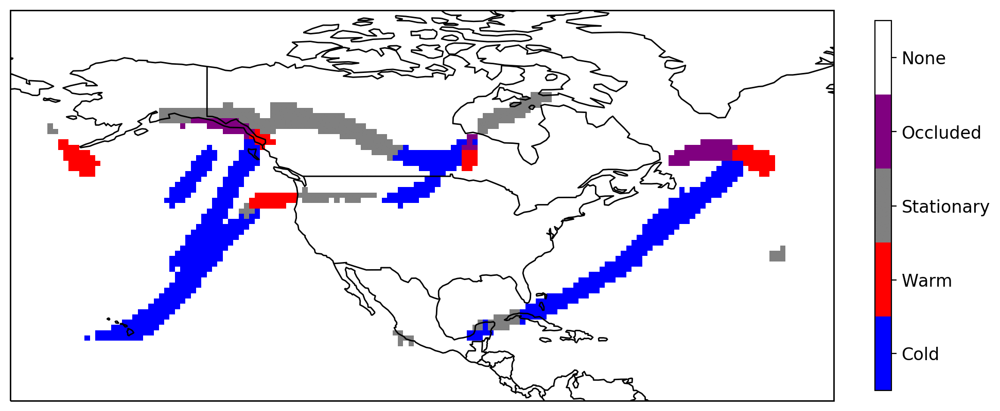

In [39]:
def show_gif(fname):
    import base64
    from IPython import display
    with open(fname, 'rb') as fd:
        b64 = base64.b64encode(fd.read()).decode('ascii')
    return display.HTML(f'<img src="data:image/gif;base64,{b64}" />')

#show_gif('../figures/fronts_animation/allfronts_2000-01-01_2000-01-31.gif')
show_gif('../figures/fronts_animation/cesm_allfronts_2000-01-01_2000-01-31.gif')
#show_gif('../figures/fronts_animation/csb_allfronts_2003-01-03_2003-01-31.gif')

## Validation data: Coded Surface Bulletin fronts

In [12]:
csb_file_path = "/glade/work/kdagon/ML-extremes/data/CODSUS/MERRA2/"
csb_fronts_file = "codsus_merra2-1deg_3wide_2003.nc"
#csb_rates_file = "codsus_frontRates_2003-2005.nc"
#csb_rates_file = "codsus_masked_frontRates_2003-2005.nc"

In [13]:
csb_fronts = xr.open_dataset(csb_file_path+csb_fronts_file)
csb_fronts

<xarray.Dataset>
Dimensions:     (front: 5, lat: 68, lon: 141, time: 2866)
Coordinates:
  * lat         (lat) float64 10.0 11.0 12.0 13.0 14.0 ... 74.0 75.0 76.0 77.0
    front_type  (front) object ...
  * lon         (lon) float64 -171.0 -170.0 -169.0 -168.0 ... -33.0 -32.0 -31.0
  * time        (time) datetime64[ns] 2003-01-03T12:00:00 ... 2003-12-31T21:00:00
Dimensions without coordinates: front
Data variables:
    crs         float64 ...
    fronts      (time, front, lat, lon) float32 ...
Attributes:
    title:        Coded surface bulletins with masking on a merra2-1deg grid.
    history:      2019-03-13T19:11:11.427012: ./../Python/jsonPolysToMaskedNe...
    institution:  North Carolina Institute for Climate Studies (NCICS)
    Conventions:  CF-1.7

In [14]:
csb_fronts_da = csb_fronts.fronts

In [15]:
csb_allfronts = csb_fronts_da.argmax(dim='front')

In [16]:
csb_allfronts.sel(time='2003-01-03T12').time.values

numpy.datetime64('2003-01-03T12:00:00.000000000')

In [17]:
csb_allfronts.sel(time='2003-01-03T12').time.dt.strftime('%Y-%m-%d %H:%M:%S').values

array('2003-01-03 12:00:00', dtype=object)

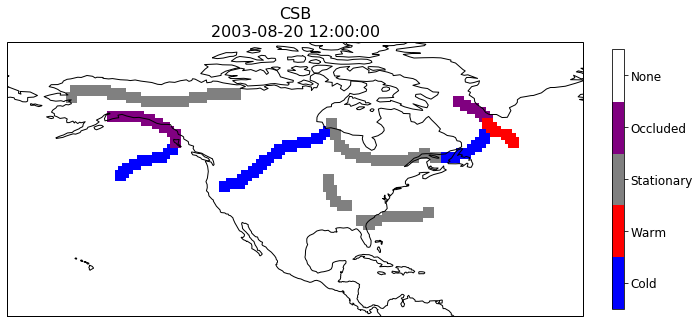

In [85]:
fig = plt.figure(figsize=(8,6))

ax = fig.add_axes([0.,0.,1.,1.], projection=ccrs.PlateCarree())

# select time index
tindex = csb_allfronts.sel(time='2003-08-20T12')
tstring = tindex.time.dt.strftime('%Y-%m-%d %H:%M:%S').values

field, lon = add_cyclic_point(tindex, coord=csb_allfronts.lon)
lat = csb_allfronts.lat
cf = ax.pcolormesh(lon, lat, field, cmap=cmap_all, vmin=0, vmax=4.99, norm=norm, transform=ccrs.PlateCarree()) # trying to get rid of contourf interpolation
ax.set_title('CSB\n'+tstring, fontsize=16)

ax.coastlines()

import matplotlib as mpl
cbar_ax = fig.add_axes([1.05, 0.2, 0.02, 0.6])
norm = mpl.colors.Normalize(vmin=0, vmax=4.99)
cb1 = mpl.colorbar.ColorbarBase(cbar_ax, 
                                cmap=cmap_all,
                                norm=norm,
                                orientation='vertical', 
                               ticks=bounds)
labels = np.array([0, 0.99, 1.99, 2.99, 3.99])
loc    = labels + .5
tick_1 = ['Cold','Warm','Stationary','Occluded','None']
cb1.set_ticks(loc)
cb1.ax.set_yticklabels(tick_1)
cb1.ax.tick_params(labelsize=12)

In [29]:
# find the corresponding time index in CESM output
allfronts.sel(time='2003-01-03T12')[0].time.dt.strftime('%Y-%m-%d %H:%M:%S').values

array('2003-01-03 12:00:00', dtype=object)

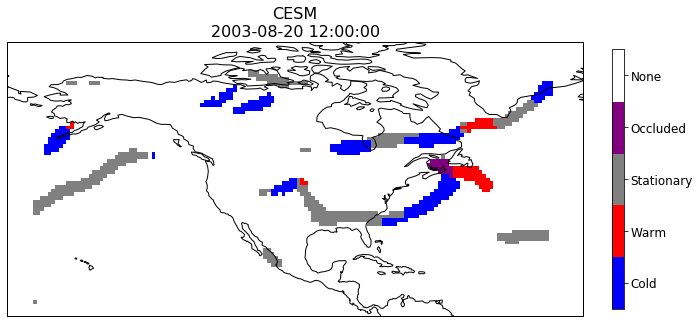

In [86]:
fig = plt.figure(figsize=(8,6))

ax = fig.add_axes([0.,0.,1.,1.], projection=ccrs.PlateCarree())

tindex = allfronts.sel(time='2003-08-20T12')[0]
tstring = tindex.time.dt.strftime('%Y-%m-%d %H:%M:%S').values

field, lon = add_cyclic_point(tindex, coord=allfronts.lon)
lat = allfronts.lat
#cf = ax.contourf(lon, lat, field, cmap=cmap_all, vmin=0, vmax=4.99, levels=bounds, transform=ccrs.PlateCarree())
cf = ax.pcolormesh(lon, lat, field, cmap=cmap_all, vmin=0, vmax=4.99, norm=norm, transform=ccrs.PlateCarree()) # trying to get rid of contourf interpolation
ax.set_title('CESM\n'+tstring, fontsize=16)

ax.coastlines()

import matplotlib as mpl
cbar_ax = fig.add_axes([1.05, 0.2, 0.02, 0.6])
norm = mpl.colors.Normalize(vmin=0, vmax=4.99)
cb1 = mpl.colorbar.ColorbarBase(cbar_ax, 
                                cmap=cmap_all,
                                norm=norm,
                                orientation='vertical', 
                               ticks=bounds)
labels = np.array([0, 0.99, 1.99, 2.99, 3.99])
loc    = labels + .5
tick_1 = ['Cold','Warm','Stationary','Occluded','None']
cb1.set_ticks(loc)
cb1.ax.set_yticklabels(tick_1)
cb1.ax.tick_params(labelsize=12)

## Compare CSB with CESM all-front snapshots

In [19]:
import cartopy.feature as cfeature

In [25]:
import matplotlib as mpl

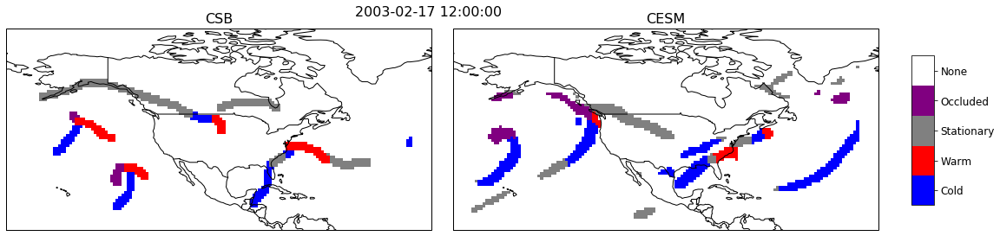

In [32]:
#fig, ax = plt.subplots(1, 2, figsize=(18,8), subplot_kw={'projection': ccrs.LambertCylindrical()})
fig, ax = plt.subplots(1, 2, figsize=(18,8), subplot_kw={'projection': ccrs.PlateCarree()})

t = '2003-02-17T12'

# CSB: select time index
tindex = csb_allfronts.sel(time=t)
tstring = tindex.time.dt.strftime('%Y-%m-%d %H:%M:%S').values

field, lon = add_cyclic_point(tindex, coord=csb_allfronts.lon)
lat = csb_allfronts.lat
cf = ax[0].pcolormesh(lon, lat, field, cmap=cmap_all, vmin=0, vmax=4.99, norm=norm, transform=ccrs.PlateCarree()) # trying to get rid of contourf interpolation
ax[0].set_title('CSB', fontsize=16)
ax[0].coastlines()
ax[0].add_feature(cfeature.BORDERS)

fig.suptitle(tstring, fontsize=16, y=0.75)

# CESM: select time index
tindex = allfronts.sel(time=t)[0]
tstring = tindex.time.dt.strftime('%Y-%m-%d %H:%M:%S').values

field, lon = add_cyclic_point(tindex, coord=allfronts.lon)
lat = allfronts.lat
cf = ax[1].pcolormesh(lon, lat, field, cmap=cmap_all, vmin=0, vmax=4.99, norm=norm, transform=ccrs.PlateCarree()) # trying to get rid of contourf interpolation
ax[1].set_title('CESM', fontsize=16)
ax[1].coastlines()
ax[1].add_feature(cfeature.BORDERS)

cbar_ax = fig.add_axes([0.93, 0.35, 0.02, 0.3])
norm = mpl.colors.Normalize(vmin=0, vmax=4.99)
cb1 = mpl.colorbar.ColorbarBase(cbar_ax, 
                                cmap=cmap_all,
                                norm=norm,
                                orientation='vertical', 
                               ticks=bounds)
labels = np.array([0, 0.99, 1.99, 2.99, 3.99])
loc    = labels + .5
tick_1 = ['Cold','Warm','Stationary','Occluded','None']
cb1.set_ticks(loc)
cb1.ax.set_yticklabels(tick_1)
cb1.ax.tick_params(labelsize=12)

plt.subplots_adjust(wspace=0.05)
#plt.savefig('allfronts_CSB_CESM_2003-02-17-12.pdf', bbox_inches='tight')
#plt.savefig('../figures/toSCP/allfronts_CSB_CESM_2003-02-17-12_PlateCarree.pdf', bbox_inches='tight')